In [1]:
import numpy as np
import scipy as sp
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
import matplotlib as mp
import sklearn
import networkx as nx
from IPython.display import Image, HTML

import laUtilities as ut

import matplotlib.animation as animation
mp.rcParams['animation.html'] = 'jshtml'

%matplotlib inline

# Improving Gradient Descent

Today we'll talk more about gradient descent.

To recall the setting we are working in: we have a loss function $\mathcal{L}(\mathbf{w})$ that we'd like to minimize.

The components of $\mathbf{w}\in\mathbb{R}^n$ are the parameters we want to optimize.

As discussed last lecture, if our problem is linear regression, the loss function could be:
    
$$\mathcal{L}(\mathbf{\beta}) = \Vert\mathbf{y} - X\mathbf{\beta}\Vert^2$$

where $X$ is our matrix of independent observations and $\mathbf{y}$ is our vector of dependent observations.

For a problem of maximizing a likelihood, we use negative log likelihood (aka cross entropy) loss.

For example, in logistic regression our loss function was:

$$\mathcal{L}(\alpha, \beta) = - \sum_i y_i \log(\sigma(\alpha + \beta x_i))+ (1-y_i) \log(1-\sigma(\alpha + \beta x_i))$$

where the $x_i$ are the independent observations and the $y_i$ are the binary-valued dependent observations.

Now, even though these loss functions are very different, we can use the same algorithm -- gradient descent -- to optimize them.   

The same is true of __any__ differentiable loss function.   In other words, gradient descent is remarkably versatile.

However, this incredible flexibility comes at a cost.   There are various ways in which "vanilla" gradient descent can fail to work well.

We will start by looking at some of the problems that can arise when using gradient descent, and then we'll look at ways to reduce those problems.

## Challenges in Using Gradient Descent

Let's start by reminding ourselves of the basic gradient descent algorithm:

1. Start with an initial parameter estimate $\mathbf{w}^0$, and a learning rate $\eta > 0$.
2. Update: $\mathbf{w}^{n+1} = \mathbf{w}^n - \eta \nabla_\mathbf{w}\mathcal{L}(\mathbf{w}^n)$
3. If not converged, go to step 2.

Unfortunately, Gradient Descent (GD) can suffer from a number of problems:
* GD has slow convergence in deep narrow valleys
* GD can get stuck in local minima
* It can be expensive (slow) to compute the gradient

We'll now look at each of these issues in turn.

```{margin}
An excellent reference for this lecture, with many great examples, is [here](https://distill.pub/2017/momentum/).  A number of examples are taken from there.
```

## Slow Convergence

Let's look at a simple example that illustrates when GD can have slow convergence.

We'll look at gradient descent on quadratic forms.

We'll compare two quadratic forms:

$\mathbf{x}^TA\mathbf{x}$ where

$$ A = \begin{bmatrix}1 & 0\\0& 1\end{bmatrix} $$

and $\mathbf{x}^TB\mathbf{x}$ where

$$ B = \begin{bmatrix}20 & 0\\0& 1\end{bmatrix} $$

In [2]:
def qf(A, x):
    return x.T @ A @ x

def gradient(A, beta):
    return 2 * A @ beta

def gradient_descent(A, beta_hat, eta, nsteps = 1000):
    losses = [qf(A, beta_hat)]
    betas = [beta_hat]
    #
    for step in range(nsteps):
        #
        # the gradient step
        new_beta_hat = beta_hat - eta * gradient(A, beta_hat)
        beta_hat = new_beta_hat
        #
        # accumulate statistics
        losses.append(qf(A, new_beta_hat))
        betas.append(new_beta_hat)
        
    return np.array(betas), np.array(losses)

def gradient_descent_mom(A, beta_hat, eta, mu, nsteps = 1000):
    losses = [qf(A, beta_hat)]
    betas = [beta_hat]
    b = 0
    #
    for step in range(nsteps):
        #
        # the momentum gradient step
        b = (mu * b) + gradient(A, beta_hat)
        new_beta_hat = beta_hat - eta * b
        beta_hat = new_beta_hat
        #
        # accumulate statistics
        losses.append(qf(A, new_beta_hat))
        betas.append(new_beta_hat)
        
    return np.array(betas), np.array(losses)

In [3]:
A_1 = np.array([[1, 0],[0, 1]])
beta_start = np.array([-4, -4])
eta = 0.3
betas_1, losses_1 = gradient_descent(A_1, beta_start, eta, nsteps = 20)

In [4]:
A_2 = np.array([[10, 0],[0, .5]])
beta_start = np.array([-1.5, -4])
eta = 2/21
betas_2, losses_2 = gradient_descent(A_2, beta_start, eta,  nsteps = 20)

In [5]:
fig = ut.three_d_figure((33, 1), '',
                        -5, 5, -5, 5, -1, 60, 
                        figsize = (6, 6))
plt.close()
fig.ax.view_init(azim = 60, elev = 35)
fig.plotGeneralQF(A_1, np.array([0, 0]), 1, alpha = 0.5)
fig.ax.set_zlabel('$\mathcal{L}$')
fig.ax.set_xlabel(r'$\beta_0$')
fig.ax.set_ylabel(r'$\beta_1$')
fig.set_title(r'GD on $\mathbf{x}^TA\mathbf{x}$', '', 
              number_fig = False, size = 18)
fig.ax.plot(betas_1[:, 0], betas_1[:, 1], 'o-', zs = losses_1,  c = 'k', markersize = 5)

def anim(frame):
    fig.ax.view_init(azim = frame, elev = 35)
    #fig.ax.plot(betas[:frame, 0], betas[:frame, 1], 'o-', zs = losses[:frame],  c = 'k', markersize = 5)
    # fig.canvas.draw()
#
# create the animation 
animation.FuncAnimation(fig.fig, anim,
                       frames = 10 * np.arange(36),
                       fargs = None,
                       interval = 1,
                       repeat = False)

In [6]:
fig = ut.three_d_figure((33, 2), '',
                        -5, 5, -5, 5, -1, 60, 
                        figsize = (6, 6))
plt.close()
fig.ax.view_init(azim = 60, elev = 35)
fig.plotGeneralQF(A_2, np.array([0, 0]), 1, alpha = 0.5)
fig.ax.set_zlabel('$\mathcal{L}$')
fig.ax.set_xlabel(r'$\beta_0$')
fig.ax.set_ylabel(r'$\beta_1$')
fig.set_title(r'GD on $\mathbf{x}^TB\mathbf{x}$', '', 
              number_fig = False, size = 18)
fig.ax.plot(betas_2[:, 0], betas_2[:, 1], 'o-', zs = losses_2,  c = 'k', markersize = 5)

def anim(frame):
    fig.ax.view_init(azim = frame, elev = 35)
    #fig.ax.plot(betas[:frame, 0], betas[:frame, 1], 'o-', zs = losses[:frame],  c = 'k', markersize = 5)
    # fig.canvas.draw()
#
# create the animation 
animation.FuncAnimation(fig.fig, anim,
                       frames = 10 * np.arange(36),
                       fargs = None,
                       interval = 1,
                       repeat = False)

```{margin}
In fact, for a quadratic problem like this one, it is actually possible to compute the optimal learning rate.
The details are presented in [the tutorial mentioned above](https://distill.pub/2017/momentum/).
The bottom line is that for a quadratic surface with largest eigenvalue $\lambda_1$ and smallest eigenvalue $\lambda_n$
the optimal rate is $\eta = \frac{2}{\lambda_1 + \lambda_2}$.   

So for this problem, the optimal 
rate is $2/(20 + 1) \approx 0.095$ which is what we use here.
```

The difference between these two loss surfaces is that $\mathbf{x}^TB\mathbf{x}$ is "deep and narrow".  In other words, it is much more curved in one direction than in the other direction.

Clearly, GD has a much more difficult time on the deep and narrow surface.

Surfaces like this are often described as valleys, trenches, canals or ravines.

How can we recognize when a loss surface has this bad "deep and narrow" property?

The amount of curvature in each direction of the loss surface is determined by the eigenvalues of the associated matrix.

The eigenvalues of $A$ are 1 and 1, while the eigenvalues of $B$ are 20 and 1.   

So the loss surface becomes challenging for gradient descent when the ratio of the largest and smallest eigenvalues grows.

This quantity is important enough that it has a name.

The ratio of the largest eigenvalue to the smallest eigenvalue of a matrix is called its __condition number.__

That is, for a matrix $A$ with eigenvalues $\lambda_1 \geq \lambda_2 \geq \dots \geq \lambda_n$, we define

$$ \kappa = \frac{\lambda_1}{\lambda_n} $$

as the condition number of $A$.

So the condition number of our $A$ is one (the best possible), while the condition number of $B$ is 20 (not great).

Because $B$ has a (relatively) large condition number, we say $B$ is "ill conditioned,"

and also that the loss surface of $\mathbf{x}^TB\mathbf{x}$ is "ill-conditioned."

It is not uncommon in practice to encounter matrices with condition numbers in the hundreds or thousands, so the problem we are looking at here can get much worse than these visualizations suggest.

So the problem is that ill-conditioned loss surfaces pose challenges for gradient descent: on those surfaces, it can be slow to converge.
    
Let's look at the convergence of GD on these two surfaces:

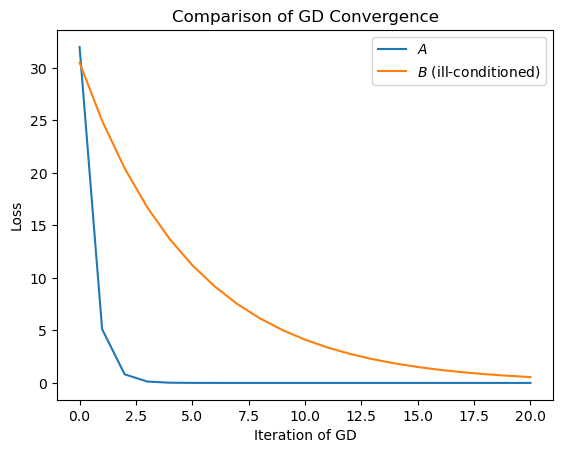

In [7]:
plt.plot(losses_1, label = '$A$')
plt.plot(losses_2, label = '$B$ (ill-conditioned)')
#plt.plot(losses_2_m)
plt.ylabel('Loss')
plt.xlabel('Iteration of GD')
plt.title('Comparison of GD Convergence')
plt.legend(loc = 'best');

So indeed, the back-and-forth behavior of GD on the $B$ surface is leading to slow convergence.

## What Can be Done?

Let's recall the basic idea of gradient descent:

<!-- Image credit http://nederlandliving.com/?p=1931 -->

<center>
    
<img src="images/fog-in-the-mountains.png" width="30%">
    
</center> 

If you were performing gradient descent in the mountains, you would: 
1. Look around you 360 degrees.  
2. Observe in which direction the ground is sloping downward most steeply.  
3. Take a few steps in that direction.  
4. Repeat the process <BR> ... until the ground seems to be level.

Notice that what you are doing after each step is __stopping__ and starting off in a new direction.

Consider, instead, what would happen if a __heavy ball were rolling down the hill__ instead.

Although the ball would tend to follow the downhill direction, it would also have momentum that would factor in to the direction that it takes.

The momentum of the ball at a given moment is a reflection of the past gradients (really forces) that the ball has experienced.   

So on an ill-conditioned surface, the conflicting gradients on either side of the "valley" can get averaged out by the ball, and before long the ball will be rolling down the "center" of the valley.

This thought experiment suggests that, rather than using just the gradient direction at each step, we should use a running __average__ of gradients in the recent past.

A simple way to do this is called "exponentially weighted moving average" (EWMA).   

This method is called, not surprisingly, __Gradient Descent with Momentum.__

It is actually very simple to implement.  Instead of using the gradient at each step, we use its exponentially weighted moving average.

We'll use the variable $\mathbf{b}$ to hold the EWMA of the gradient.

1. Start with 
    * an initial parameter estimate $\mathbf{w}^0$, 
    * a learning rate $\eta > 0$, 
    * $\mathbf{b}^0=\mathbf{0}$, 
    * and a momentum factor $0 < \mu < 1$.
2. Compute EWMA of gradient: <BR>$\mathbf{b}^{n+1} = \mu \cdot \mathbf{b}^{n} + \nabla_\mathbf{w}\mathcal{L}(\mathbf{w}^{n})$
2. Update: <BR>$\mathbf{w}^{n+1} = \mathbf{w}^n - \eta \cdot \mathbf{b}^{n+1}$
3. If not converged, go to step 2.

And we can see that the implementation isn't too different from regular gradient descent:  

In [8]:
def gradient_descent(A, beta_hat, eta, nsteps = 1000):
    losses = [qf(A, beta_hat)]
    betas = [beta_hat]
    #
    for step in range(nsteps):
        #
        # the gradient step
        new_beta_hat = beta_hat - eta * gradient(A, beta_hat)
        beta_hat = new_beta_hat
        #
        # accumulate statistics
        losses.append(qf(A, new_beta_hat))
        betas.append(new_beta_hat)
        
    return np.array(betas), np.array(losses)

def gradient_descent_mom(A, beta_hat, eta, mu, nsteps = 1000):
    losses = [qf(A, beta_hat)]
    betas = [beta_hat]
    b = 0
    #
    for step in range(nsteps):
        #
        # the momentum gradient step
        b = (mu * b) + gradient(A, beta_hat)
        new_beta_hat = beta_hat - eta * b
        beta_hat = new_beta_hat
        #
        # accumulate statistics
        losses.append(qf(A, new_beta_hat))
        betas.append(new_beta_hat)
        
    return np.array(betas), np.array(losses)

Notice that to use momentum, we need a new hyperparameter, $\mu$.

The value of $\mu$ should be between 0 and 1; a value of zero results in regular gradient descent, and larger values incorporate more momentum.   For some problems, values of $\mu$ as large as 0.99 or 0.999 may be needed.

Like any hyperparameter, $\mu$ is best set by cross-validation.

OK, so let's look at how GD with Momentum does on our ill-conditioned surface:

```{margin}
Once again, for a quadratic problem, it is  possible to compute the optimal momentum parameter.
For a quadratic surface with largest eigenvalue $\lambda_1$ and smallest eigenvalue $\lambda_n$
the optimal momentum parameter is $\mu = \left(\frac{\sqrt{\lambda_1}-\sqrt{\lambda_n}}{\sqrt{\lambda_1}+\sqrt{\lambda_n}}\right)^2$.   

So for this problem, the optimal 
$\mu$ is $((\sqrt{20}-1)/(\sqrt{20} + 1))^2 \approx 0.40$ which is what we use here.
```

In [9]:
# betas_2_m, losses_2_m = gradient_descent_mom(A_2, beta_start, eta = 2/21, mu = 0.45, nsteps = 20)
# see https://distill.pub/2017/momentum/ for the rationale for these settings
lamn = np.sqrt(20)
eta = (2/(1 + lamn))**2
mu = ((lamn - 1)/(lamn + 1))**2
# using the optimal eta results in large oscillations which mess up the visualization
betas_2_m, losses_2_m = gradient_descent_mom(A_2, beta_start, eta = 2/21, mu = mu, nsteps = 20)

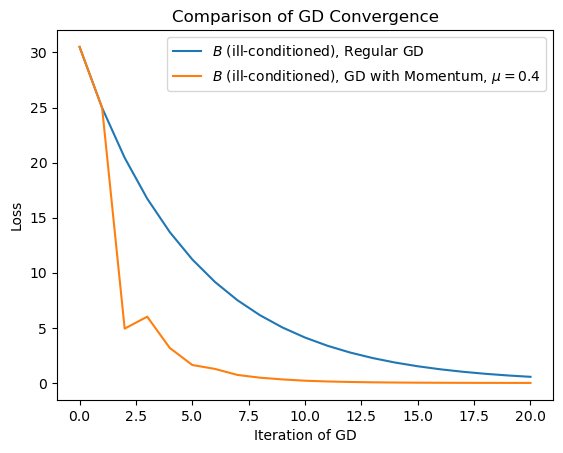

In [10]:
# plt.plot(losses_1, label = '$A$')
plt.plot(losses_2, label = '$B$ (ill-conditioned), Regular GD')
plt.plot(losses_2_m, label = f'$B$ (ill-conditioned), GD with Momentum, $\mu = {mu:0.2}$')
plt.ylabel('Loss')
plt.xlabel('Iteration of GD')
plt.title('Comparison of GD Convergence')
plt.legend(loc = 'best');

Clearly, momentum makes a huge difference!

You can see that the very first step taken by the momentum version is the same as regular GD.

However, after that, the influence of previous gradients helps guide the process toward the minimum very quickly.

To visualize the benefit of momentum, let's compare GD with and without momentum on the ill-conditioned loss surface:

In [11]:
fig = ut.three_d_figure((33, 2), '',
                        -5, 5, -5, 5, -1, 60, 
                        figsize = (6, 6))
plt.close()
fig.ax.view_init(azim = 60, elev = 35)
fig.plotGeneralQF(A_2, np.array([0, 0]), 1, alpha = 0.5)
fig.ax.set_zlabel('$\mathcal{L}$')
fig.ax.set_xlabel(r'$\beta_0$')
fig.ax.set_ylabel(r'$\beta_1$')
fig.set_title(r'GD on $\mathbf{x}^TB\mathbf{x}$', '', 
              number_fig = False, size = 18)
fig.ax.plot(betas_2[:, 0], betas_2[:, 1], 'o-', zs = losses_2,  c = 'k', markersize = 5)

def anim(frame):
    fig.ax.view_init(azim = frame, elev = 35)
    #fig.ax.plot(betas[:frame, 0], betas[:frame, 1], 'o-', zs = losses[:frame],  c = 'k', markersize = 5)
    # fig.canvas.draw()
#
# create the animation 
animation.FuncAnimation(fig.fig, anim,
                       frames = 10 * np.arange(36),
                       fargs = None,
                       interval = 1,
                       repeat = False)

In [12]:
fig = ut.three_d_figure((33, 3), '',
                        -5, 5, -5, 5, -1, 60, 
                        figsize = (6, 6))
plt.close()
fig.ax.view_init(azim = 60, elev = 35)
fig.plotGeneralQF(A_2, np.array([0, 0]), 1, alpha = 0.5)
fig.ax.set_zlabel('$\mathcal{L}$')
fig.ax.set_xlabel(r'$\beta_0$')
fig.ax.set_ylabel(r'$\beta_1$')
fig.set_title(r'GD with Momentum on $\mathbf{x}^TB\mathbf{x}$', '', 
              number_fig = False, size = 18)
fig.ax.plot(betas_2_m[:, 0], betas_2_m[:, 1], 'o-', zs = losses_2_m,  c = 'k', markersize = 5)

def anim(frame):
    fig.ax.view_init(azim = frame, elev = 35)
    #fig.ax.plot(betas[:frame, 0], betas[:frame, 1], 'o-', zs = losses[:frame],  c = 'k', markersize = 5)
    # fig.canvas.draw()
#
# create the animation 
animation.FuncAnimation(fig.fig, anim,
                       frames = 10 * np.arange(36),
                       fargs = None,
                       interval = 1,
                       repeat = False)

Looking at the case with momentum, one can see how the "ball rolling downhill" gradually settles in to the valley, and soon starts to follow the valley down directly.

What momentum has done is __reduce oscillations__ that occur on a poorly conditioned surface.

```{margin}
The following examples are from the [Cornell Optimization Wiki](https://optimization.cbe.cornell.edu/index.php?title=Momentum).
```

## Local Minima

The second problem associated with regular Gradient Descent has to do with local minima.

Recall that unlike a convex function, a non-convex loss function can have multiple local minima.

This mean that the first local minimum found is not guaranteed to be the global minimum. 

At the local minimum, the gradient of the cost function will be very small or zero.   Because of this, gradient descent will get stuck and fail to find the global optimal solution.

To see the effect of local minima, let's look at an example in 1D.

Let's use this as a loss function of a single variable $x$:

$$ y = 0.3\,x^4 - 0.1\,x^3 - 2\,x^2 - 0.8\,x $$

In [13]:
def f(x):
    return 0.3 * x**4 - 0.1 * x**3 - 2 * x**2 - 0.8 * x

def grad_f(x):
    return 1.2 * x**3 - 0.3 * x**2 - 4 * x - 0.8

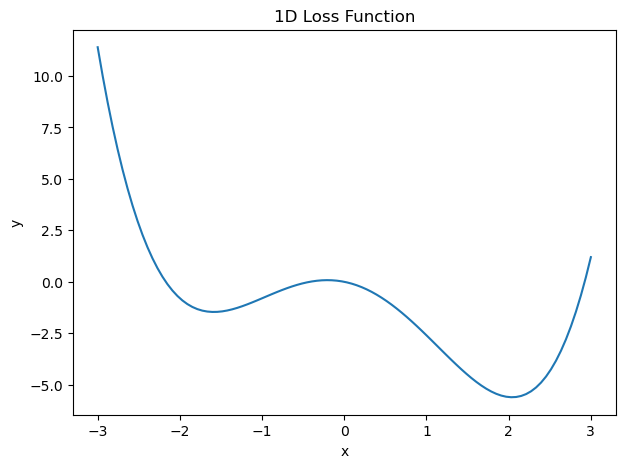

In [14]:
fig, ax = plt.subplots(1, 1, figsize = (7,5))
xvals = np.linspace(-3, 3, 100)
yvals = [f(x) for x in xvals]
plt.plot(xvals, yvals)
plt.ylabel('y')
plt.xlabel('x')
plt.title('1D Loss Function');

Let's look at how regular GD behaves on this "surface":

In [15]:
def gradient_descent_1D(f, grad_f, x0, eta, nsteps = 1000):
    beta_hat = x0
    losses = [f(beta_hat)]
    betas = [beta_hat]
    #
    for step in range(nsteps):
        #
        # the gradient step
        new_beta_hat = beta_hat - eta * grad_f(beta_hat)
        beta_hat = new_beta_hat
        #
        # accumulate statistics
        losses.append(f(new_beta_hat))
        betas.append(new_beta_hat)
        
    return np.array(betas), np.array(losses)

def gradient_descent_mom_1D(f, grad_f, x0, eta, mu, nsteps = 1000):
    beta_hat = x0
    losses = [f(beta_hat)]
    betas = [beta_hat]
    b = 0
    #
    for step in range(nsteps):
        #
        # the momentum gradient step
        b = (mu * b) + grad_f(beta_hat)
        new_beta_hat = beta_hat - eta * b
        beta_hat = new_beta_hat
        #
        # accumulate statistics
        losses.append(f(new_beta_hat))
        betas.append(new_beta_hat)
        
    return np.array(betas), np.array(losses)

In [16]:
x0 = -2.8
eta = 0.05
nsteps = 25
betas, losses = gradient_descent_1D(f, grad_f, x0, eta, nsteps = nsteps)

In [17]:
fig, ax = plt.subplots(1, 1, figsize = (7,5))
plt.close()
xvals = np.linspace(-3, 3, 100)
yvals = [f(x) for x in xvals]
ax.plot(xvals, yvals)
ax.set_ylabel('y')
ax.set_xlabel('x')
ax.set_title('Regular GD on 1D Loss Function')

anim_frames = range(nsteps)

def anim(frame):
    ax.plot(betas[:frame], losses[:frame], 'o-', c = 'k', markersize = 5)
    # fig.canvas.draw()
#
# create the animation 
animation.FuncAnimation(fig, anim,
                       frames = anim_frames,
                       fargs = None,
                       interval = 1,
                       repeat = False)

This is what we expect from regular GD: it moves downward into the first local minimum that it finds.

However, this isn't good: we are in a local minimum, and we have not found the better solution at the global minimum.

Now let's try adding momentum.  We'll use a momentum parameter of $\mu = 0.7$.

In [18]:
nsteps = 50
betas_1, losses_1 = gradient_descent_mom_1D(f, grad_f, x0, eta, mu = 0.7, nsteps = nsteps)

In [19]:
fig, ax = plt.subplots(1, 1, figsize = (7,5))
plt.close()
xvals = np.linspace(-3, 3, 100)
yvals = [f(x) for x in xvals]
ax.plot(xvals, yvals)
ax.set_ylabel('y')
ax.set_xlabel('x')
ax.set_title('GD with Momentum, $\mu = 0.7,$ 1D Loss Function')

anim_frames = range(nsteps)

def anim(frame):
    ax.plot(betas_1[:frame], losses_1[:frame], 'o-', c = 'k', markersize = 5)
    # fig.canvas.draw()
#
# create the animation 
animation.FuncAnimation(fig, anim,
                       frames = anim_frames,
                       fargs = None,
                       interval = 1,
                       repeat = False)

This is much better!

Notice how adding momentum causes the solver to move past the local minimum and find the global minimum.  

This, momentum has a __second__ beneficial effect on gradient descent: it can allow GD to __escape local minima.__

While this behavior is desirable, there is unfortunately no simple relationship between the value of the momentum parameter $\mu$ and the quality of the final solution.

For example, if we use $\mu = 0.65$ (a little less momentum), we observe:

In [20]:
nsteps = 50
betas_2, losses_2 = gradient_descent_mom_1D(f, grad_f, x0, eta, mu = 0.65, nsteps = nsteps)

In [21]:
fig, ax = plt.subplots(1, 1, figsize = (7,5))
plt.close()
xvals = np.linspace(-3, 3, 100)
yvals = [f(x) for x in xvals]
ax.plot(xvals, yvals)
ax.set_ylabel('y')
ax.set_xlabel('x')
ax.set_title('GD with Momentum, $\mu = 0.65,$ 1D Loss Function')

anim_frames = range(nsteps)

def anim(frame):
    ax.plot(betas_2[:frame], losses_2[:frame], 'o-', c = 'k', markersize = 5)
    # fig.canvas.draw()
#
# create the animation 
animation.FuncAnimation(fig, anim,
                       frames = anim_frames,
                       fargs = None,
                       interval = 1,
                       repeat = False)

In this case, the solver does not benefit from enough momentum to escape the local minimum.   No improvement over regular GD.

On the other hand, if we use a larger amount of momentum ($\mu = 0.9$) we observe:

In [22]:
nsteps = 50
betas_3, losses_3 = gradient_descent_mom_1D(f, grad_f, x0, eta, mu = 0.9, nsteps = nsteps)

In [23]:
fig, ax = plt.subplots(1, 1, figsize = (7,5))
plt.close()
xvals = np.linspace(-3, 3, 100)
yvals = [f(x) for x in xvals]
ax.plot(xvals, yvals)
ax.set_ylabel('y')
ax.set_xlabel('x')
ax.set_title('GD with Momentum, $\mu = 0.9,$ 1D Loss Function')

anim_frames = range(nsteps)

def anim(frame):
    ax.plot(betas_3[:frame], losses_3[:frame], 'o-', c = 'k', markersize = 5)
    # fig.canvas.draw()
#
# create the animation 
animation.FuncAnimation(fig, anim,
                       frames = anim_frames,
                       fargs = None,
                       interval = 1,
                       repeat = False)

In this case, the solver finds the global minimum, but "rolls" back and forth in the valley, thus taking a long time to converge to the true minimum

### In Practice

Remember that in practice, you cannot "see" the actual loss surface.   

Instead, the best you can do is plot the value of the loss function as a function of the number of steps the algorithm has taken.   

For example, in the case we've been studying the best you could do would be to generate a plot like this:

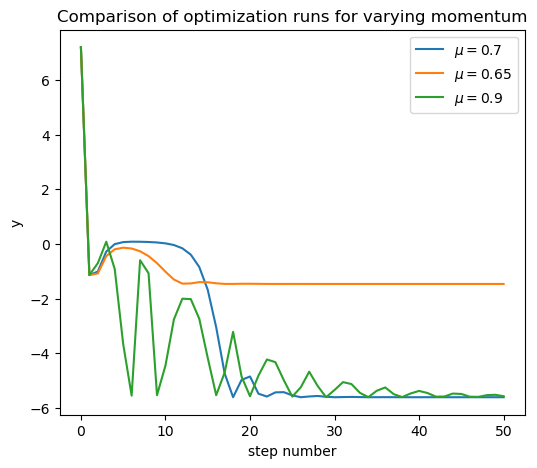

In [24]:
fig, ax = plt.subplots(1, 1, figsize = (6, 5))
ax.plot(losses_1, label = '$\mu = 0.7$')
ax.plot(losses_2, label = '$\mu = 0.65$')
ax.plot(losses_3, label = '$\mu = 0.9$')
ax.set_xlabel('step number')
ax.set_ylabel('y')
plt.legend(loc = 'best')
ax.set_title('Comparison of optimization runs for varying momentum');

Notice how these curves seem to get worse, then better, repeatedly.  It can be tricky to decide when to "stop" the optimization, and how exactly the $\mu$ parameter relates to the quality of the solution.

## Slow Gradient Computation

The third problem we'll look at is the cost of computing gradients.

Why is the gradient expensive to compute?

Consider a machine learning setting where we are trying to optimize a loss function. 

We have a set of data points $\mathbf{x}_i$ and their labels.  We are trying to learn a model $f_\theta(\mathbf{x})$ such that for each $\mathbf{x}_i$, $f_\theta(\mathbf{x}_i)$ is a good approximation to $y_i$.

Then we can write our loss function as:

$$ \mathcal{L}(\theta) = \sum_i d(f_\theta(\mathbf{x}_i) - y_i) $$

where $d()$ is some dissimilarity (error) measure.

The gradient of this loss funcion is 

$$ \nabla_\theta\mathcal{L}(\theta) = \nabla_\theta \sum_i d(f_\theta(\mathbf{x}_i) - y_i) $$

Now, if we have a lot of data, the number of data points is large and the sum in the above expression has many terms.

For a large dataset, that means that computing the gradient can take a lot of time.

Now by the rules of differentiation, the desrivative of a sum is the sum of the derivatives, so:
    
$$ \nabla_\theta\mathcal{L}(\theta) =  \sum_i \nabla_\theta d(f_\theta(\mathbf{x}_i) - y_i) $$

This shows that the gradient of a loss function is made up of one term for each data point.  

The term for each data point is simply the gradient that would exist if that were the only data point.

As we discussed last time, this suggests the use of __stochastic gradient descent__.

The idea of __stochastic gradient descent__ is: 

Instead of computing the gradient based on all the data, compute it based on a single data point.  

Take a step in the direction of that gradient.

Then repeat the above, iterating over every data point.

In the last lecture, we ran stochastic gradient descent on a least-squares problem:

In [25]:
np.random.seed(1)
n = 10
beta = np.array([1., 0.5])
xlin = -10.0 + 20.0 * np.random.random(n)
y = beta[0] + (beta[1] * xlin) + np.random.randn(n)
X = np.column_stack([np.ones((n, 1)), xlin])

In [26]:
def loss(X, y, beta):
    return np.linalg.norm(y - X @ beta) ** 2

def point_gradient(x, y, beta):
    return (x.T @ beta - y) * x

def stochastic_gradient_descent(X, y, beta_hat, eta, nsteps = 1000):
    losses = [loss(X, y, beta_hat)]
    betas = [beta_hat]
    #
    for step in range(nsteps):
        #
        for i in range(X.shape[0]):
            #
            # the gradient step
            new_beta_hat = beta_hat - eta * point_gradient(X[i], y[i], beta_hat)
            beta_hat = new_beta_hat
            #
            # accumulate statistics
            losses.append(loss(X, y, new_beta_hat))
            betas.append(new_beta_hat)
        
    return np.array(betas), np.array(losses)

def stochastic_gradient_descent_mom(X, y, beta_hat, eta, mu, nsteps = 1000):
    losses = [loss(X, y, beta_hat)]
    betas = [beta_hat]
    b = np.zeros(np.shape(beta_hat))
    #
    for step in range(nsteps):
        #
        for i in range(X.shape[0]):
            #
            # the gradient step with momentum
            b = (mu * b) + point_gradient(X[i], y[i], beta_hat)
            new_beta_hat = beta_hat - eta * b
            beta_hat = new_beta_hat
            #
            # accumulate statistics
            losses.append(loss(X, y, new_beta_hat))
            betas.append(new_beta_hat)
        
    return np.array(betas), np.array(losses)

In [27]:
beta_start = np.array([-8, -3.2])
eta = 0.002
betas_1, losses_1 = stochastic_gradient_descent(X, y, beta_start, eta, nsteps = 10)

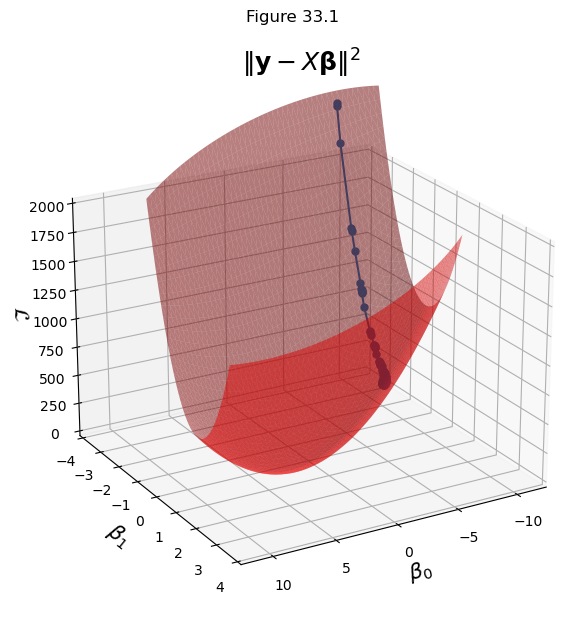

In [28]:
fig = ut.three_d_figure((33, 1), '',
                        -12, 12, -4, 4, -1, 2000, 
                        figsize = (7, 7))
fig.ax.view_init(azim = 60, elev = 22)
fig.plotGeneralQF(X.T @ X, -2 * (y.T @ X), y.T @ y, alpha = 0.5)
fig.ax.set_zlabel('$\mathcal{L}$')
fig.ax.set_xlabel(r'$\beta_0$')
fig.ax.set_ylabel(r'$\beta_1$')
fig.set_title(r'$\Vert \mathbf{y}-X\mathbf{\beta}\Vert^2$', '', 
              number_fig = False, size = 18)
nplot = 4000
fig.ax.plot(betas_1[:nplot, 0], betas_1[:nplot, 1], 'o-', zs = losses_1[:nplot], markersize = 5);

This strategy goes a long way to reducing the cost of computing gradients.

However, it's not perfect.  

Notice that, because the gradient at each step is based only on a __single__ data point, the solver's progress is erratic, and it tends to wander away from the true gradient.  It is not as efficient as it could be.

We can see this by looking at estimates of the parameters over time:

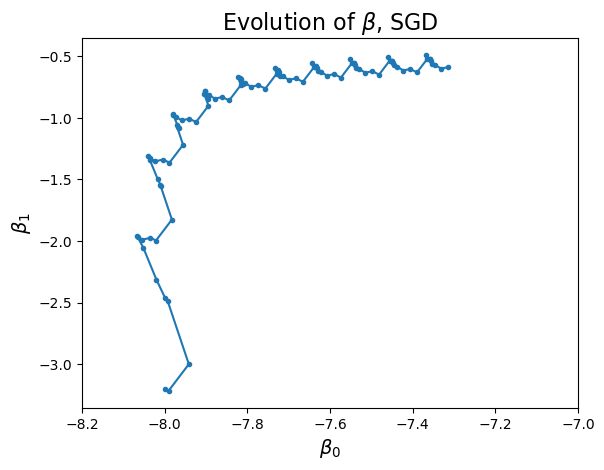

In [29]:
plt.plot(betas_1[:, 0], betas_1[:, 1], '.-')
plt.xlabel(r'$\beta_0$', size = 14)
plt.ylabel(r'$\beta_1$', size = 14)
plt.xlim([-8.2, -7])
plt.title(r'Evolution of $\beta$, SGD', size = 16);

In [30]:
beta_start = np.array([-8, -3.2])
eta = 0.002
betas_2, losses_2 = stochastic_gradient_descent_mom(X, y, beta_start, eta, mu = 0.6, nsteps = 10)

However, this erratic behavior can be reduced by ... 

... you guessed it, __momentum.__

Let's apply __stochastic__ gradient descent __with momentum:__

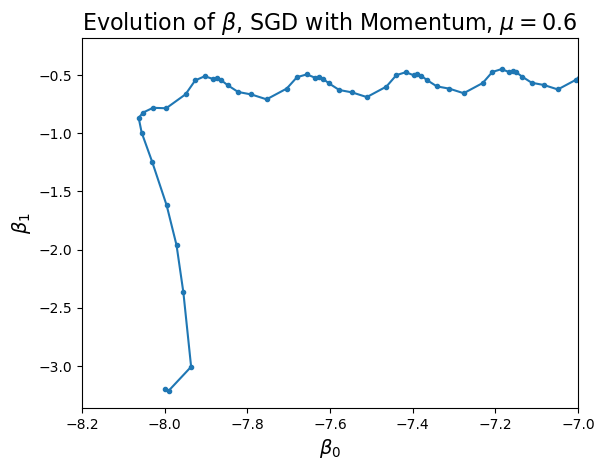

In [31]:
plt.plot(betas_2[:, 0], betas_2[:, 1], '.-')
plt.xlabel(r'$\beta_0$', size = 14)
plt.ylabel(r'$\beta_1$', size = 14)
plt.xlim([-8.2, -7])
plt.title(r'Evolution of $\beta$, SGD with Momentum, $\mu = 0.6$', size = 16);

Turns out momentum is just what we need to "smooth out" the erratic behavior of stochastic GD, and as a result stochastic GD converges faster with momentum:

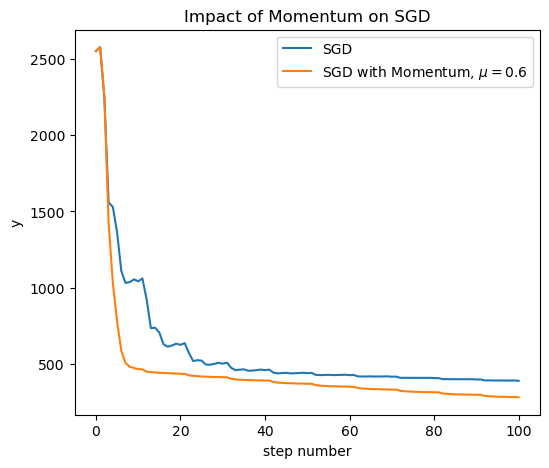

In [32]:
fig, ax = plt.subplots(1, 1, figsize = (6, 5))
ax.plot(losses_1, label = 'SGD')
ax.plot(losses_2, label = 'SGD with Momentum, $\mu = 0.6$')
ax.set_xlabel('step number')
ax.set_ylabel('y')
plt.legend(loc = 'best')
ax.set_title('Impact of Momentum on SGD');

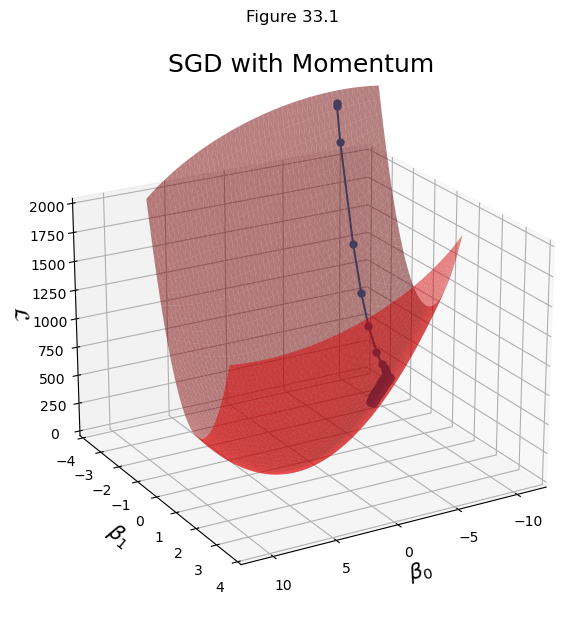

In [33]:
fig = ut.three_d_figure((33, 1), '',
                        -12, 12, -4, 4, -1, 2000, 
                        figsize = (7, 7))
fig.ax.view_init(azim = 60, elev = 22)
fig.plotGeneralQF(X.T @ X, -2 * (y.T @ X), y.T @ y, alpha = 0.5)
fig.ax.set_zlabel('$\mathcal{L}$')
fig.ax.set_xlabel(r'$\beta_0$')
fig.ax.set_ylabel(r'$\beta_1$')
fig.set_title(r'SGD with Momentum', '', 
              number_fig = False, size = 18)
nplot = 200
fig.ax.plot(betas_2[:nplot, 0], betas_2[:nplot, 1], 'o-', zs = losses_2[:nplot], markersize = 5);

## Conclusion

We conclude that momentum is a powerful addition to gradient descent (regular or stochastic).

It is quite easy to implement, and it helps with three major problems that regular gradient descent encounters:
* Slow convergence on ill-conditioned loss functions
* Avoidance of local minima
* Erratic behavior of stochastic gradient descent

And of course, people have thought about gradient descent methods a lot! 

There are many possible other ways to improve on the general algorithm, which I am sure all of you will encounter in real world applications. For example, you could dynamically change the learning rate ("annealing") or use per-parameter learning rates.

But the fundemental principles and code are virtually the same!